# fishSearch

#### Imports and Upload

Import all functions from the fishSearch folder

In [1]:
from fishSearch.fishSearch import *

/opt/miniconda3/envs/test/lib/python3.7/site-packages/bigfish/segmentation/nuc_segmentation.py:16: FutureWarning: The `skimage.morphology.selem` module is deprecated and will be removed in scikit-image 1.0 (`skimage.morphology.selem` has been moved to `skimage.morphology.footprints`).
  from skimage.morphology.selem import disk


This function (read_img) is responsible for importing the image stack, the output from this function is the image object and the name that will be used for file generation

In [3]:
img, img_name = read_img()

NameError: name 'read_img' is not defined

#### Image Abstraction

Need to choose between 3D and 2D spot detection.

In [2]:
dimension = int(input("What kind of analysis will you be performing (2D or 3D spot detection)? Please enter 2 or 3 respectively"))

What kind of analysis will you be performing (2D or 3D spot detection)? Please enter 2 or 3 respectively 2


This function (seperate_channels) is responsible for seperating the DAPI and FISH channels for analysis. The separated image stacks will be saved under data in the folder separated_channels.

In [17]:
separate_channels(img, img_name)

This image has 2 channels
This image has 15 z-slices
This image has 2048 pixels on the x-axis
This image has 2048 pixels on the y-axis


This function (generate_projections) will create 2D (max projection) images from the Z-stack for both channels, these images will be used to plot and show t

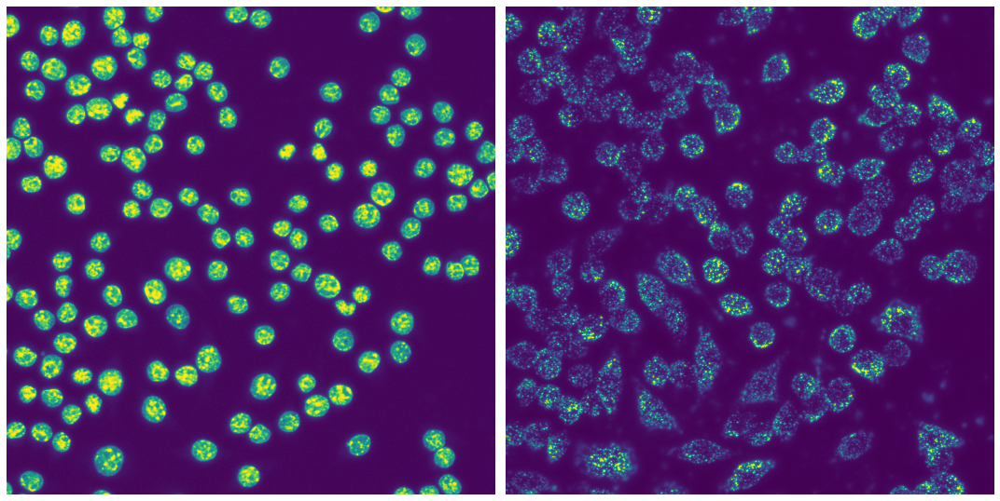

In [18]:
views = generate_projections(img)
DAPI_3D = views[0]
DAPI_2D = views[1]
RNA_3D = views[2]
RNA_2D = views[3]

#### Segmentation

This function (cell_nuc_segmentation) will use cellpose and watershed algorithms to generate a mask for both the cell nuclei and boundary by using the DAPI channel and FISH channel respectively. The segmentation can be varied for diamater and threshold respectively to improve the segmentation. The function will return a nucleus and cell mask.

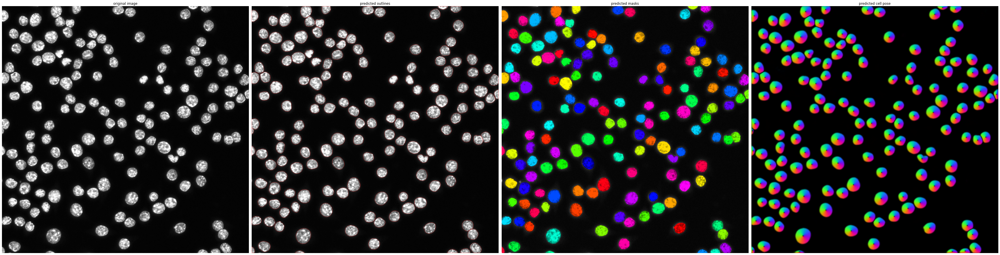

In [ ]:
nuc_label, cell_label = cell_nuc_segmentation(DAPI_2D, RNA_3D, RNA_2D, 100, 50)

#### Spot Detection

At this step please stop and complete the spot detection on FIJI with the rsFISH plugin. Save and upload the file into data under the rsfish_analysis folder. This next function (rs_spots) will read in the csv for the spot detection (2D or 3D) and will map the spots. The returned object contains the coordinates for the mapped spots.

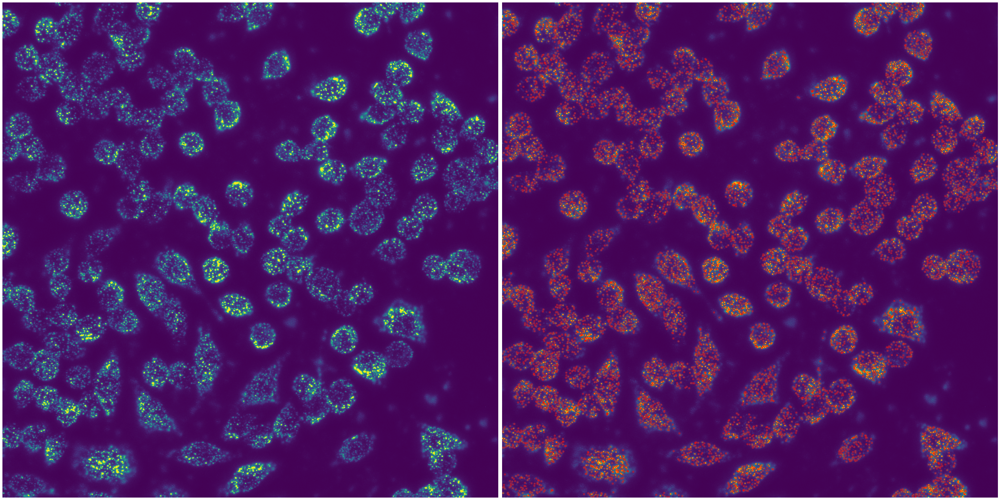

In [10]:
rs_spots = rsfish_analysis(RNA_2D, dimension)

#### Cell Level Analysis

This function (fov_results) will take in the rs_spots object and map the spot detection to specific cells based on the masks that were created previosuly. It will generate an object (fov_results) this contains the cellular level information. 

In [21]:
fov_results = cell_extraction(nuc_label, cell_label, rs_spots, RNA_2D, dimension)

detected spots (inside nuclei)
 shape: (6420, 2)
 dtype: float64 

detected spots (outside nuclei)
 shape: (5277, 2)
 dtype: float64
number of cells identified: 118


This function (spotCount) will export out the spot per cell information from the fov_results object and create a csv saved under data graph_data that contains all the detected cells and spot intensities. 

In [23]:
spotCount(fov_results,img_name)

This function (maxMinCount) will export out the maximum spots detected in a cell and the mininum spots detected in a cell and create a csv saved under data graph_data that contains the two values.

In [24]:
maxMinCount(fov_results,img_name)

This function (spotIntensity) will export out the average intensity of spots in a cell from the fov_results object and create a csv saved under data graph_data that contains the two values.

In [25]:
spotIntensity(cell_label, rs_spots, img_name)

This function (cell_level_visualization) will provide a visualization of each cell detected and the location of spots detected within that cell.

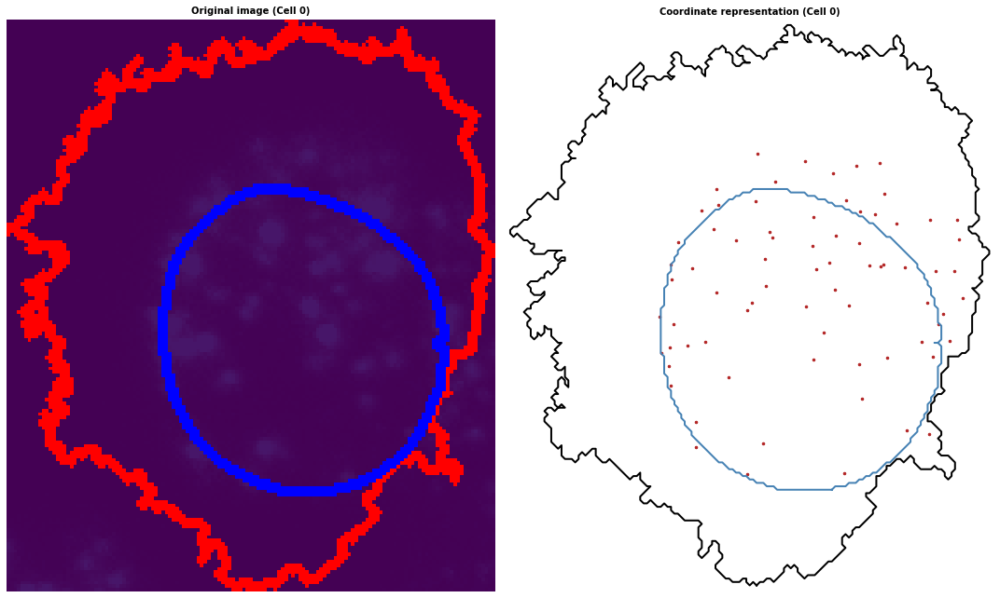

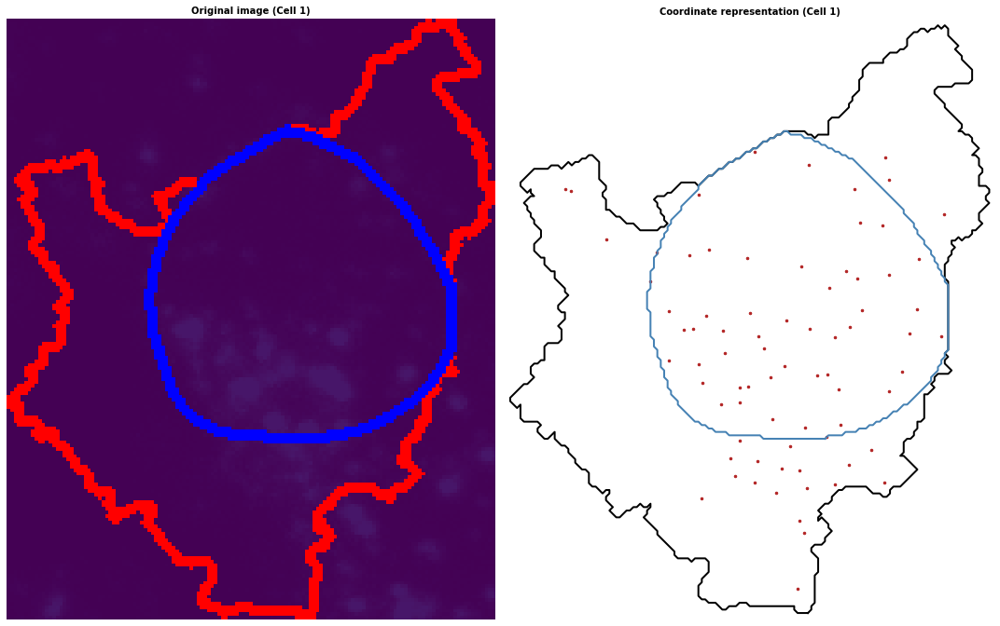

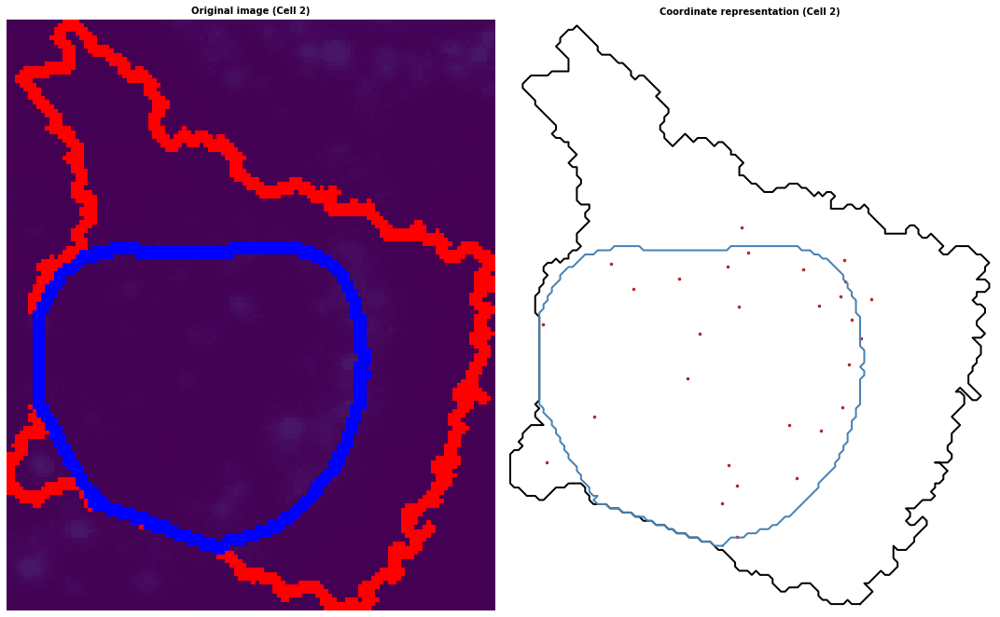

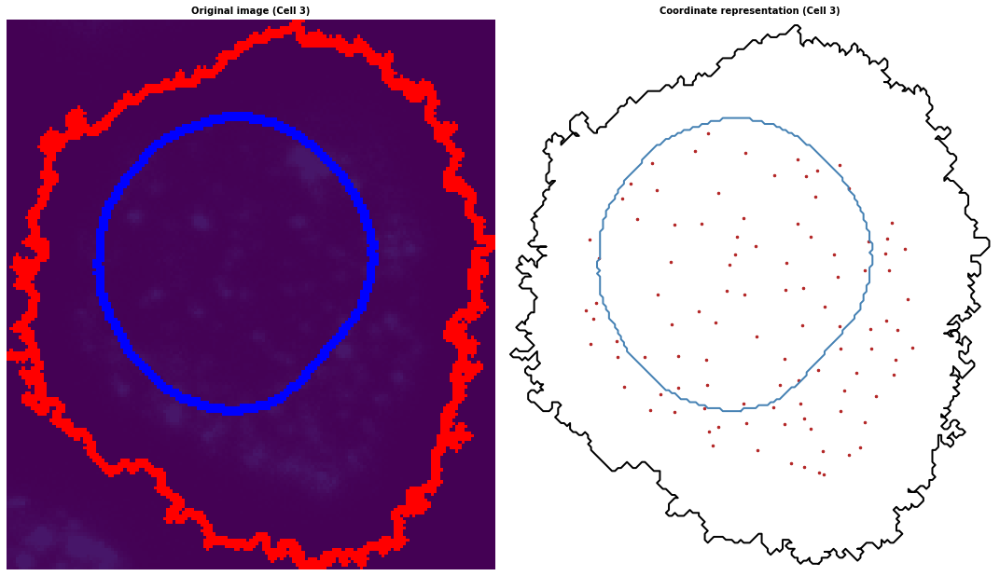

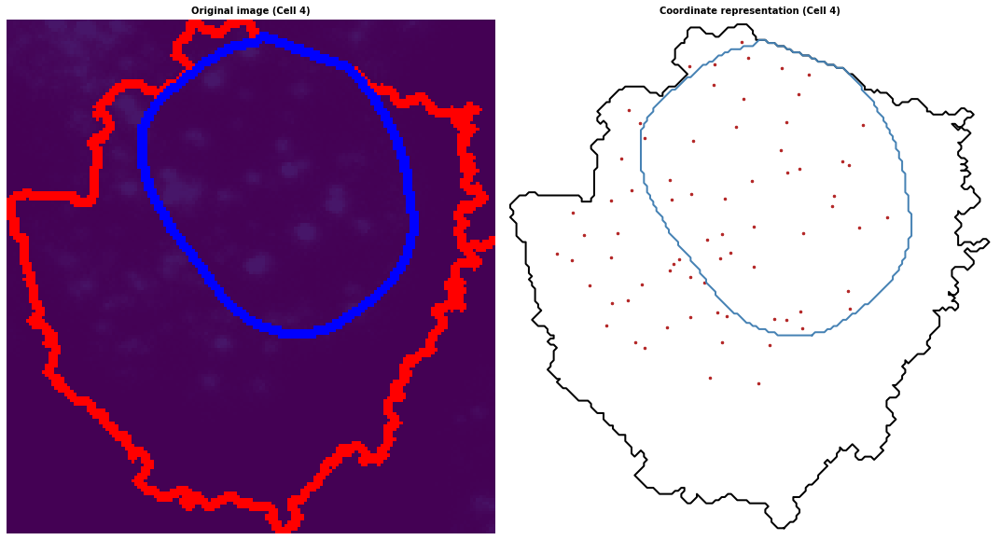

...

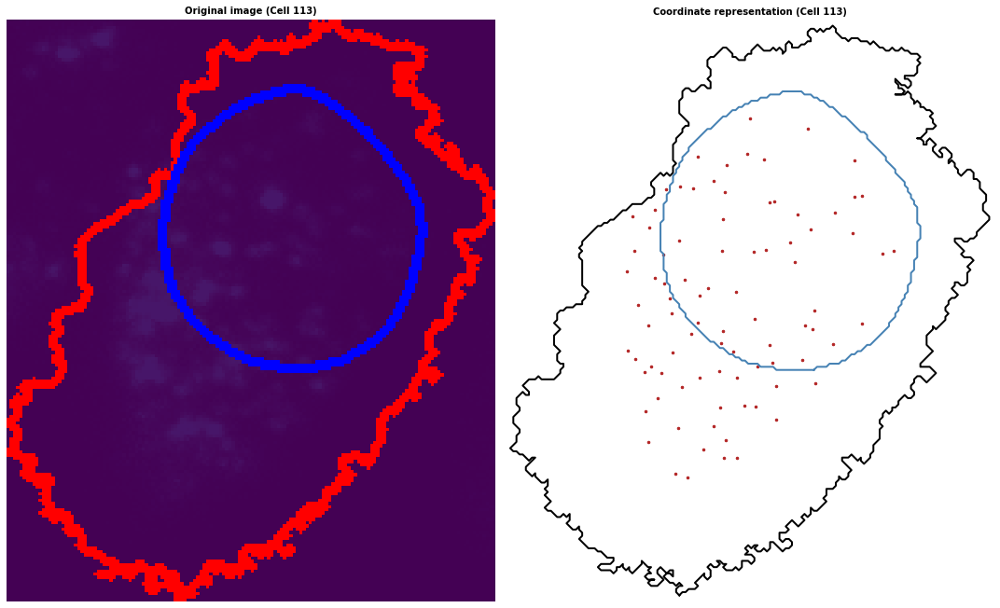

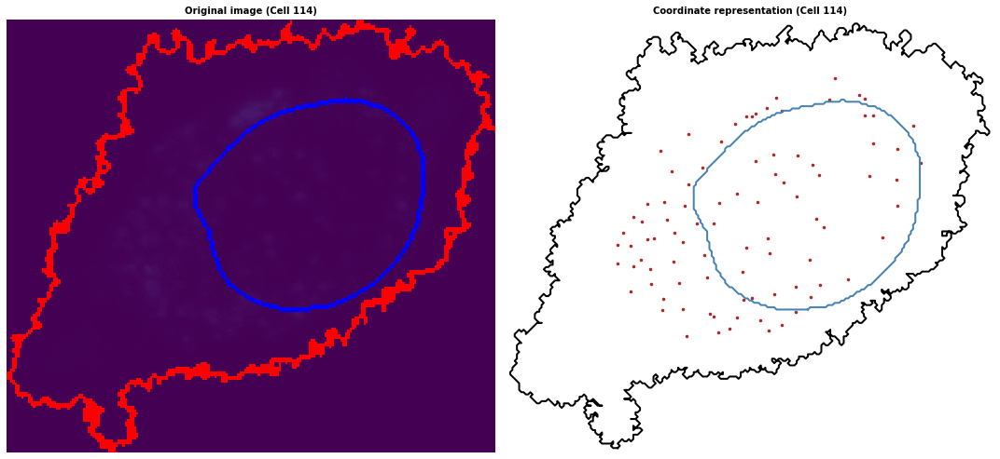

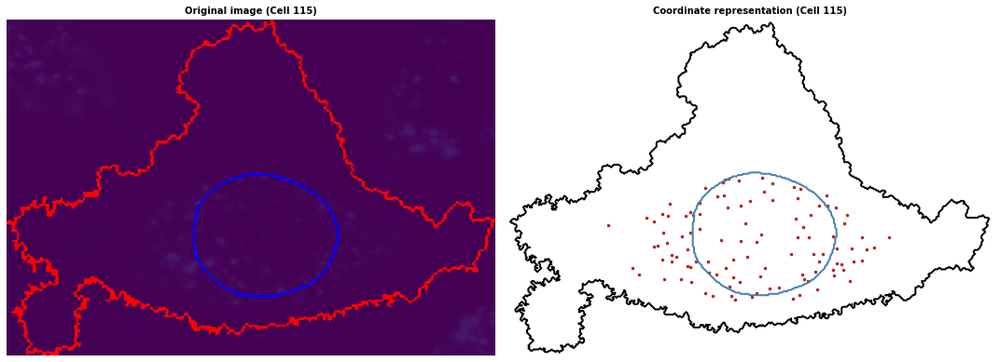

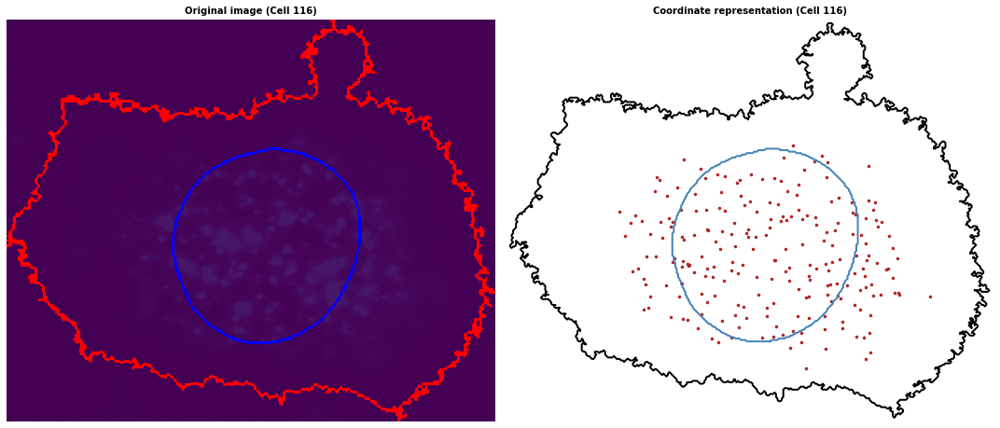

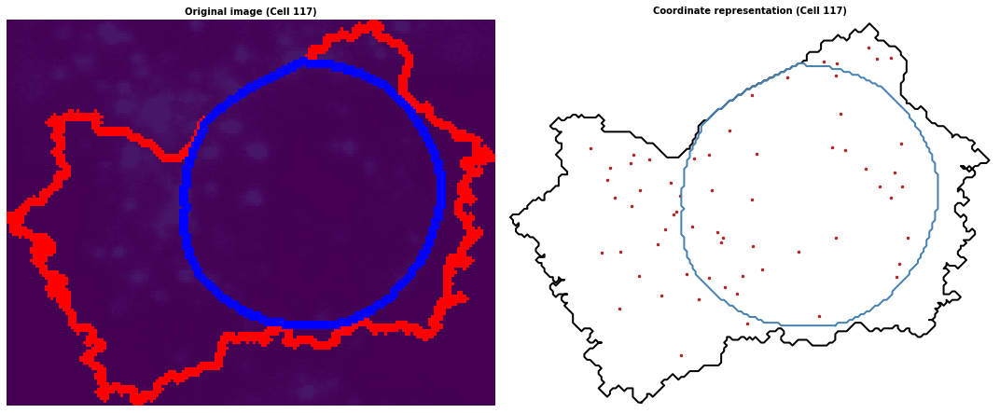

In [22]:
cell_level_visualization(fov_results, dimension)